### Importar Librerías

In [1]:
import pandas as pd
import numpy as np
from scipy import stats
import plotly.graph_objects as go
import cufflinks as cf
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler,PowerTransformer
from sklearn.model_selection import RandomizedSearchCV, train_test_split,cross_val_score

from sklearn.feature_selection import SelectPercentile, chi2, SelectKBest, f_classif, f_regression,mutual_info_classif
from sklearn.linear_model import LogisticRegression, Ridge
from sklearn.model_selection import RandomizedSearchCV, train_test_split,cross_val_score
from sklearn.ensemble import VotingClassifier,RandomForestClassifier
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler,PowerTransformer
from imblearn.over_sampling import SMOTE
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import RepeatedStratifiedKFold, GridSearchCV
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline
from sklearn.metrics import classification_report, make_scorer, roc_auc_score
from sklearn import svm

### Cargar Información

In [2]:
df = pd.read_csv('fatigue.csv')
df.head()

,da/dN,log da/dN,?K,log ?K,Temperature,Minimum grain size,Maximum grain size,Difference in grain size between,1st step Heat Treatment,1st Duration,...,W,Ta,Hf,Re,Y2O3,R-ratio,Short or long crack growth,Sample thickness,Yield stress,Unnamed: 53
0,6.400000e-08,-7.19,6.2,0.792392,293,11,13,0.0,1353,4.0,...,0.0,0.0,0.0,0,0.0,0.8,1,12.5,1021.0,NaN
1,7.000000e-08,-7.15,6.3,0.799341,293,11,13,0.0,1353,4.0,...,0.0,0.0,0.0,0,0.0,0.8,1,12.5,1021.0,NaN
2,7.300000e-08,-7.14,6.4,0.806180,293,11,13,0.0,1353,4.0,...,0.0,0.0,0.0,0,0.0,0.8,1,12.5,1021.0,NaN
3,9.400000e-08,-7.03,6.5,0.812913,293,11,13,0.0,1353,4.0,...,0.0,0.0,0.0,0,0.0,0.8,1,12.5,1021.0,NaN
4,1.600000e-07,-6.80,6.7,0.826075,293,11,13,0.0,1353,4.0,...,0.0,0.0,0.0,0,0.0,0.8,1,12.5,1021.0,NaN


In [3]:
df = df.drop(columns=['Unnamed: 53'])

In [4]:
alloys = pd.read_csv('samples.csv')

In [5]:
alloys.head()

,Sample,Ni,Cr,Co,Mo,Al,Ti,Fe,C,B,...,S,Sn,Pb,Bi,Ag,W,Ta,Hf,Re,Y2O3
0,1,54.916,15.40,17.00,5.20,4.00,3.40,0.00,0.030,0.0240,...,0.000,0.0000,0.00000,0.000000,0.00000,0.0,0.0,0.0,0,0.0
1,2,40.000,15.00,0.00,6.00,0.30,3.00,35.56,0.040,0.1000,...,0.000,0.0000,0.00000,0.000000,0.00000,0.0,0.0,0.0,0,0.0
2,3,54.916,0.03,17.00,5.20,4.00,3.40,0.00,0.030,0.0240,...,0.000,0.0000,0.00000,0.000000,0.00000,0.0,0.0,0.0,0,0.0
3,4,52.960,18.60,0.00,3.10,0.40,0.90,18.50,0.040,0.0000,...,0.000,0.0000,0.00000,0.000000,0.00000,0.0,0.0,0.0,0,0.0
4,5,52.900,18.03,0.36,3.09,0.62,1.03,18.28,0.035,0.0053,...,0.001,0.0027,0.00004,0.000013,0.00001,0.0,0.0,0.0,0,0.0


In [6]:
alloys.columns

Index(['Sample', 'Ni', 'Cr', 'Co', 'Mo', 'Al', 'Ti', 'Fe', 'C', 'B', 'Zr',
       'Si', 'Nb', 'Mn', 'Cu', 'P', 'Ca', 'Mg', 'S', 'Sn', 'Pb', 'Bi', 'Ag',
       'W', 'Ta', 'Hf', 'Re', 'Y2O3'],
      dtype='object')

In [7]:
alloys_cols = ['Ni', 'Cr', 'Co', 'Mo', 'Al', 'Ti', 'Fe', 'C', 'B', 'Zr',
       'Si', 'Nb', 'Mn', 'Cu', 'P', 'Ca', 'Mg', 'S', 'Sn', 'Pb', 'Bi', 'Ag',
       'W', 'Ta', 'Hf', 'Re', 'Y2O3']

### Ingeniería de Variables

In [8]:
df = df.merge(alloys, on=alloys_cols, how='left')
df

,da/dN,log da/dN,?K,log ?K,Temperature,Minimum grain size,Maximum grain size,Difference in grain size between,1st step Heat Treatment,1st Duration,...,W,Ta,Hf,Re,Y2O3,R-ratio,Short or long crack growth,Sample thickness,Yield stress,Sample
0,6.400000e-08,-7.190000,6.20,0.792392,293,11,13,0.0,1353,4.0,...,0.0,0.0,0.0,0,0.0,0.8,1,12.5,1021.0,1
1,7.000000e-08,-7.150000,6.30,0.799341,293,11,13,0.0,1353,4.0,...,0.0,0.0,0.0,0,0.0,0.8,1,12.5,1021.0,1
2,7.300000e-08,-7.140000,6.40,0.806180,293,11,13,0.0,1353,4.0,...,0.0,0.0,0.0,0,0.0,0.8,1,12.5,1021.0,1
3,9.400000e-08,-7.030000,6.50,0.812913,293,11,13,0.0,1353,4.0,...,0.0,0.0,0.0,0,0.0,0.8,1,12.5,1021.0,1
4,1.600000e-07,-6.800000,6.70,0.826075,293,11,13,0.0,1353,4.0,...,0.0,0.0,0.0,0,0.0,0.8,1,12.5,1021.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1889,1.750000e-04,-3.756962,15.59,1.190000,973,60,60,0.0,1373,4.0,...,0.0,0.0,0.0,0,0.0,0.7,1,25.0,903.0,20
1890,2.280000e-04,-3.642065,17.96,1.250000,973,60,60,0.0,1373,4.0,...,0.0,0.0,0.0,0,0.0,0.7,1,25.0,903.0,20
1891,2.980000e-04,-3.525784,20.28,1.310000,973,60,60,0.0,1373,4.0,...,0.0,0.0,0.0,0,0.0,0.7,1,25.0,903.0,20
1892,3.640000e-04,-3.438899,22.89,1.360000,973,60,60,0.0,1373,4.0,...,0.0,0.0,0.0,0,0.0,0.7,1,25.0,903.0,20


In [9]:
df = df.sort_values(by=['Sample', 'da/dN'])

In [10]:
df['cambio_da/dN'] = df.groupby('Sample')['da/dN'].diff()

In [11]:
shape_org = df.shape
shape_org

(1894, 55)

In [12]:
df = df.dropna(subset=['cambio_da/dN'])

In [13]:
df.isnull().sum()

da/dN                               0
log da/dN                           0
?K                                  0
log ?K                              0
Temperature                         0
Minimum grain size                  0
Maximum grain size                  0
Difference in grain size between    0
1st step Heat Treatment             0
1st Duration                        0
1st Colling rate                    0
2nd step Heat Treatment             0
2nd Duration                        0
2nd Colling rate                    0
3rd step Heat Treatment             0
3 rd Duration                       0
3 rd Colling rate                   0
Frequency                           0
Loading Time                        0
Untoading Time                      0
Load shape                          0
Atmosphere                          0
Ni                                  0
Cr                                  0
Co                                  0
Mo                                  0
Al          

In [14]:
Q1 = df['cambio_da/dN'].quantile(0.25)
Q3 = df['cambio_da/dN'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

df['ModoFalla_I'] = np.where(df['?K'] < lower_bound, 1, 0)

df['ModoFalla_III'] = np.where(df['?K'] > upper_bound, 1, 0)

df.head()

,da/dN,log da/dN,?K,log ?K,Temperature,Minimum grain size,Maximum grain size,Difference in grain size between,1st step Heat Treatment,1st Duration,...,Re,Y2O3,R-ratio,Short or long crack growth,Sample thickness,Yield stress,Sample,cambio_da/dN,ModoFalla_I,ModoFalla_III
81,1.700000e-08,-7.77,10.0,1.000000,293,40,50,0.0,1423,4.0,...,0,0.0,0.5,1,12.5,954.0,1,2.000000e-09,0,1
59,3.200000e-08,-7.49,7.5,0.875061,293,40,50,0.0,1423,4.0,...,0,0.0,0.8,1,12.5,954.0,1,1.500000e-08,0,1
82,3.400000e-08,-7.47,10.1,1.004321,293,40,50,0.0,1423,4.0,...,0,0.0,0.5,1,12.5,954.0,1,2.000000e-09,0,1
30,3.600000e-08,-7.44,6.0,0.778151,293,11,13,0.0,1353,4.0,...,0,0.0,0.5,1,12.5,1021.0,1,2.000000e-09,0,1
58,4.300000e-08,-7.37,7.3,0.863323,293,40,50,0.0,1423,4.0,...,0,0.0,0.8,1,12.5,954.0,1,7.000000e-09,0,1


In [15]:
umbral_modo_falla_III = 0.0000490

# Etiquetar ModoFalla_III como 1 si ?K es mayor que el umbral
df['ModoFalla_III'] = np.where(df['cambio_da/dN'] > umbral_modo_falla_III, 1, 0)

In [16]:
df['ModoFalla_III'].value_counts()

ModoFalla_III
0    1385
1     489
Name: count, dtype: int64

In [17]:
df['ModoFalla_I'].value_counts()

ModoFalla_I
0    1874
Name: count, dtype: int64

In [18]:
df = df.drop(columns=['ModoFalla_I'])

In [19]:
def encontrar_variables_unarias(df):
    unarias = [col for col in df.columns if df[col].nunique() == 1]
    return unarias

In [20]:
variables_unarias = encontrar_variables_unarias(df)
print("Variables unarias:", variables_unarias)

Variables unarias: []


### EDA

#### Separación de Variables

In [21]:
Vars = ['da/dN', 'log da/dN', '?K', 'log ?K', 'Temperature',
       'Minimum grain size', 'Maximum grain size',
       'Difference in grain size between', '1st step Heat Treatment',
       '1st Duration', '1st Colling rate', '2nd step Heat Treatment',
       '2nd Duration', '2nd Colling rate', '3rd step Heat Treatment',
       '3 rd Duration', '3 rd Colling rate', 'Frequency', 'Loading Time',
       'Untoading Time', 'Load shape', 'Atmosphere', 'Ni', 'Cr', 'Co', 'Mo',
       'Al', 'Ti', 'Fe', 'C', 'B', 'Zr', 'Si', 'Nb', 'Mn', 'Cu', 'P', 'Ca',
       'Mg', 'S', 'Sn', 'Pb', 'Bi', 'Ag', 'W', 'Ta', 'Hf', 'Re', 'Y2O3',
       'R-ratio', 'Short or long crack growth', 'Sample thickness',
       'Yield stress', 'Sample', 'cambio_da/dN', 'ModoFalla_III']

In [22]:
VarC = ['da/dN', 'log da/dN', '?K', 'log ?K', 'Temperature',
       'Minimum grain size', 'Maximum grain size',
       'Difference in grain size between', '1st step Heat Treatment',
       '1st Duration', '1st Colling rate', '2nd step Heat Treatment',
       '2nd Duration', '2nd Colling rate', '3rd step Heat Treatment',
       '3 rd Duration', '3 rd Colling rate', 'Frequency', 'Loading Time',
       'Untoading Time', 'Load shape', 'Atmosphere', 'Ni', 'Cr', 'Co', 'Mo',
       'Al', 'Ti', 'Fe', 'C', 'B', 'Zr', 'Si', 'Nb', 'Mn', 'Cu', 'P', 'Ca',
       'Mg', 'S', 'Sn', 'Pb', 'Bi', 'Ag', 'W', 'Ta', 'Hf', 'Re', 'Y2O3',
       'R-ratio', 'Short or long crack growth', 'Sample thickness',
       'Yield stress', 'Sample', 'cambio_da/dN', ]

In [23]:
VarD = ['Load shape','Short or long crack growth','Sample', 'ModoFalla_III']

In [24]:
target = 'log da/dN'

In [25]:
def histograma(df, columnas):
    tam = (500, 500)
    for col in columnas:
        fig = go.Figure(data=[go.Histogram(x=df[col])])
        fig.update_layout(title=f'Histógrama columna {col}',xaxis_title=col, width=tam[0],height=tam[1])
        fig.show()

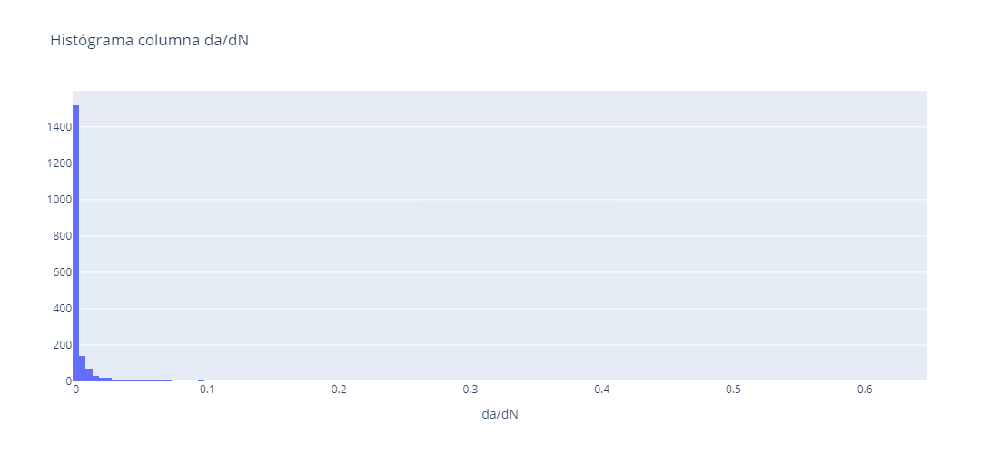

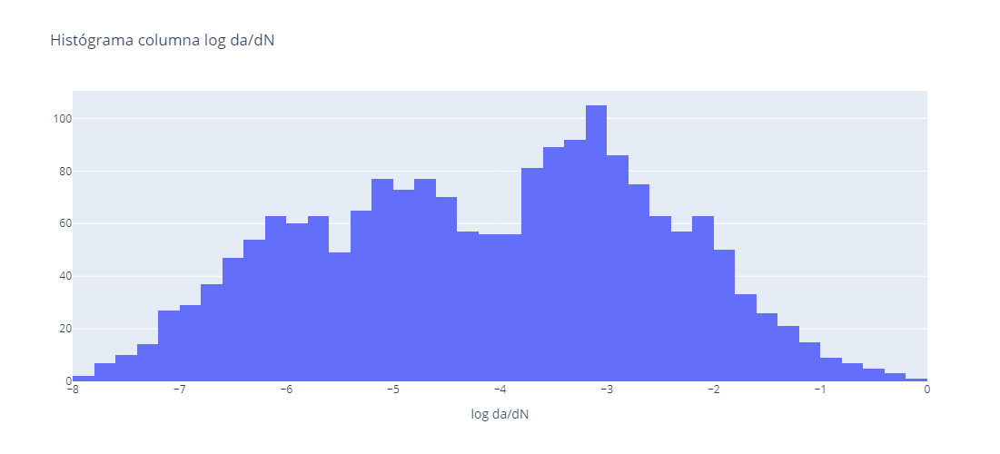

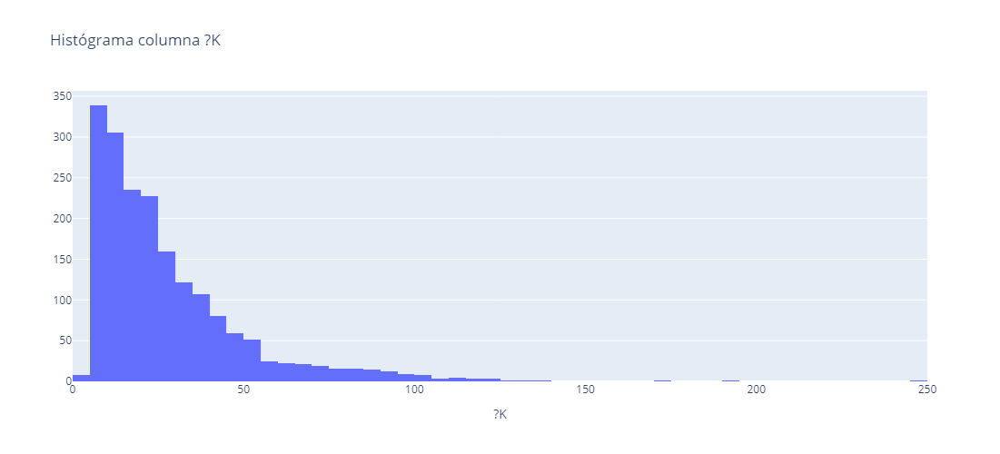

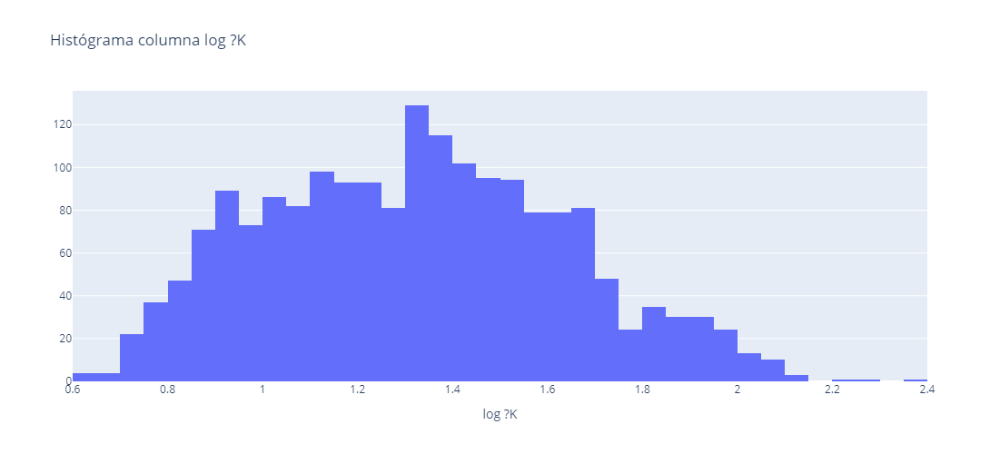

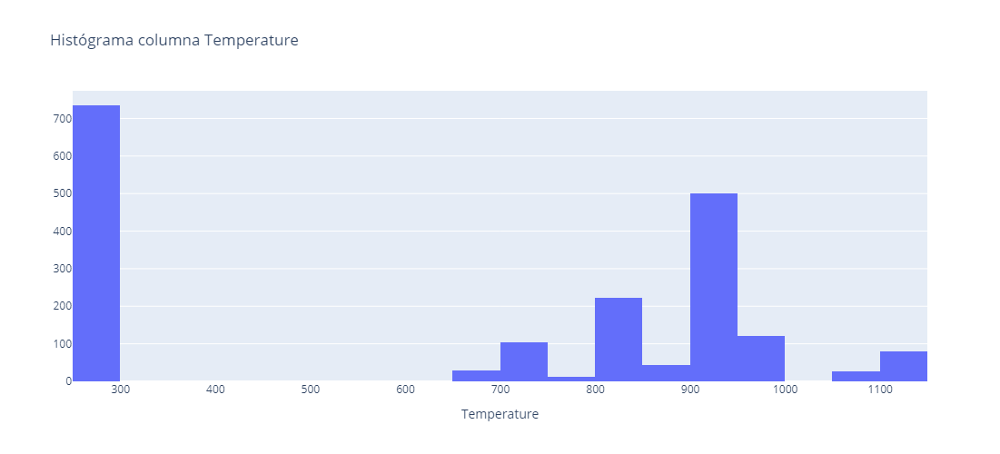

...

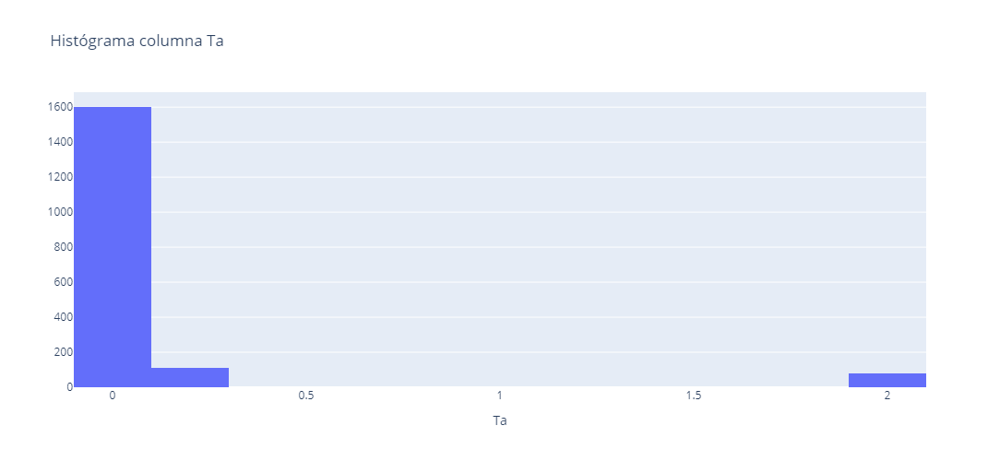

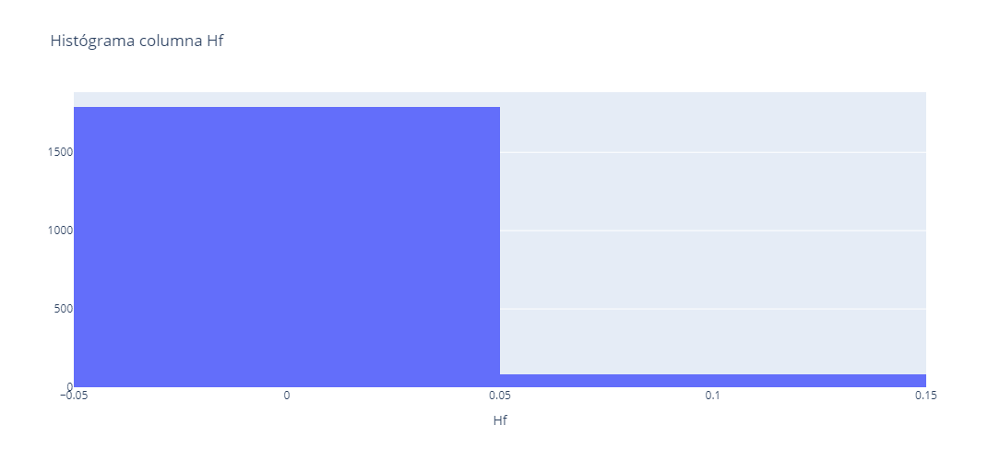

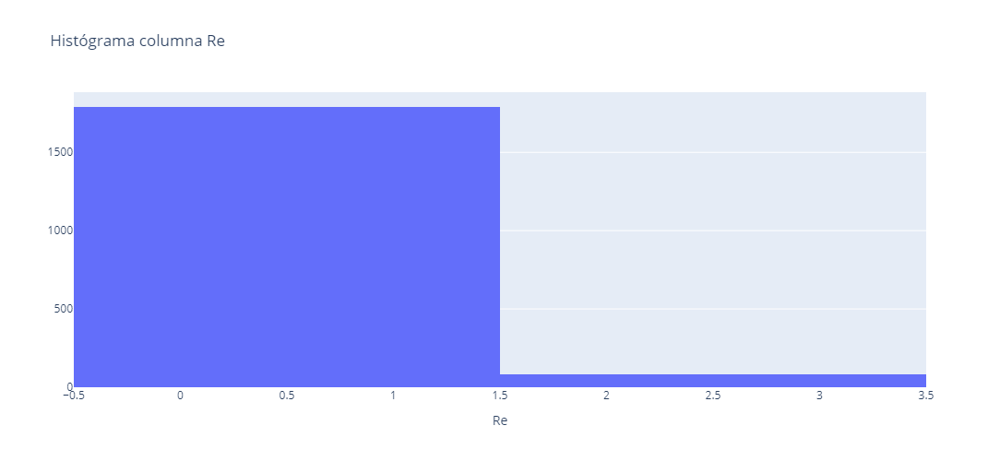

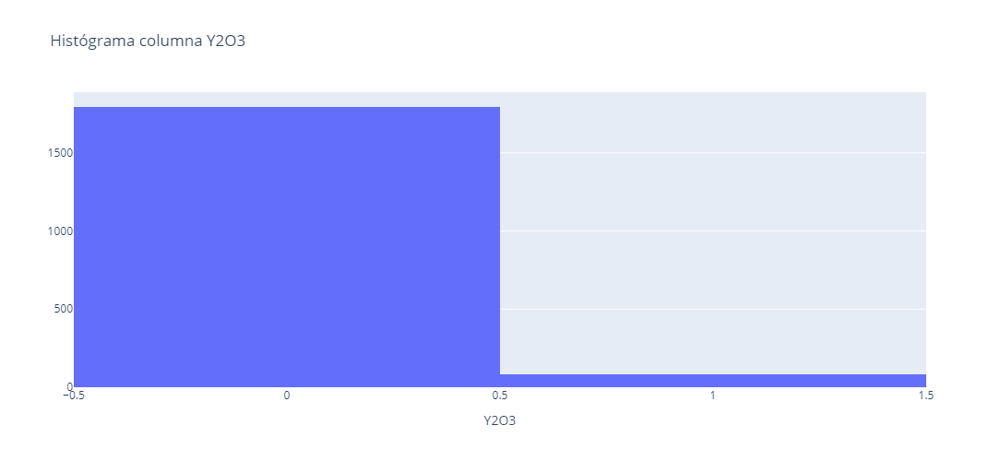

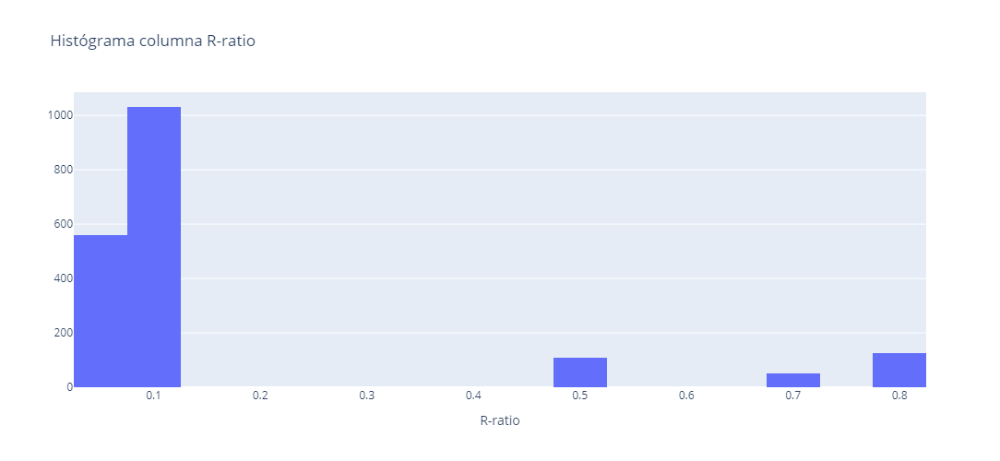

In [26]:
 histograma(df, VarC)

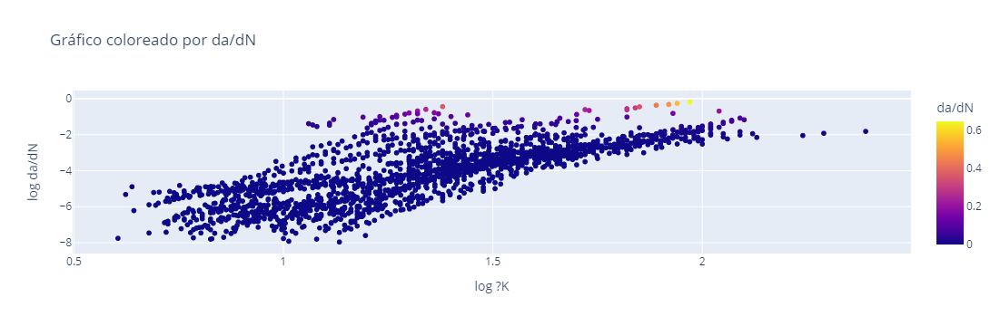

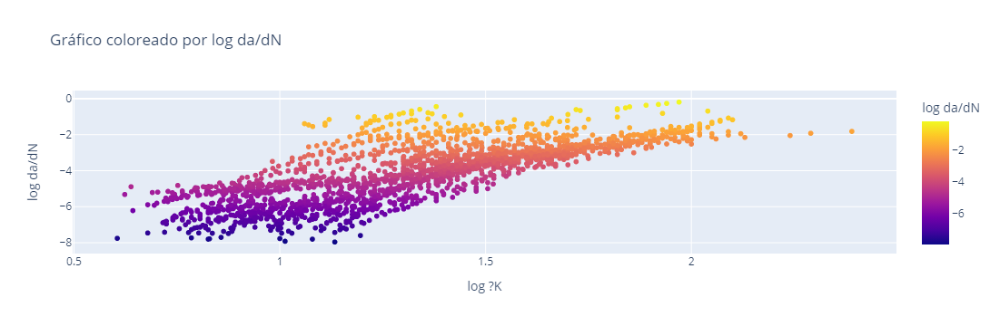

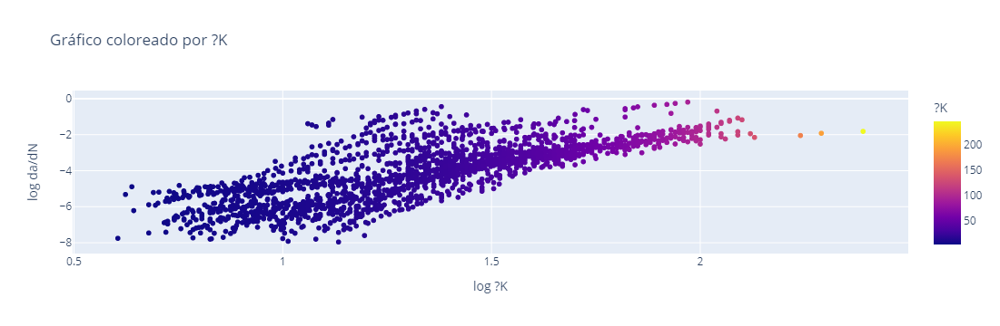

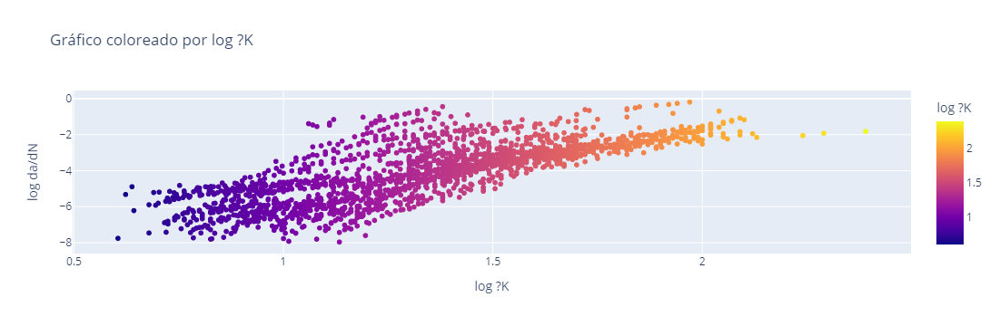

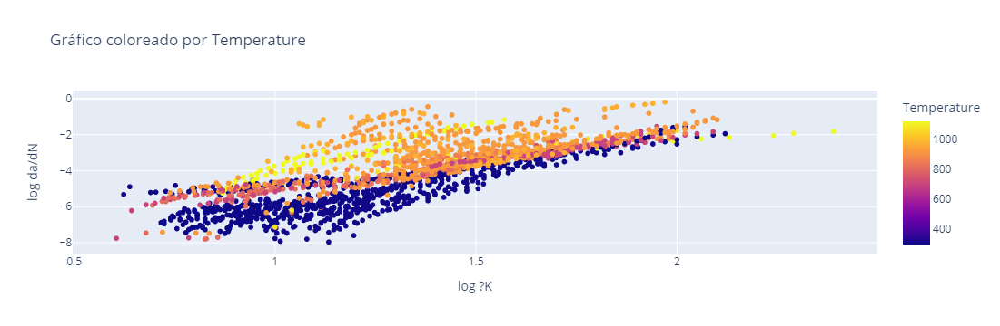

...

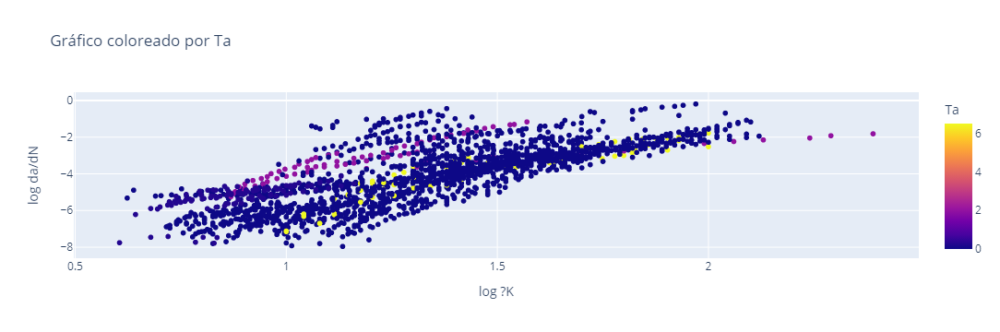

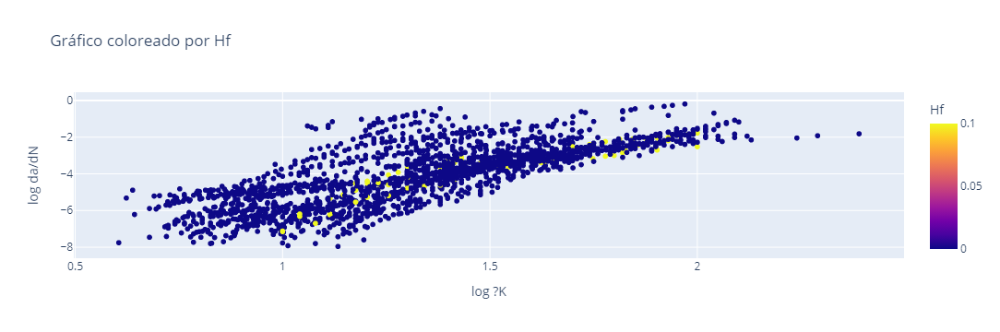

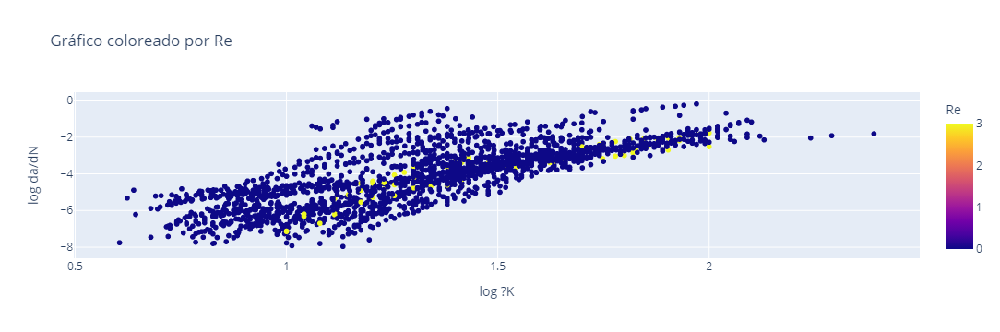

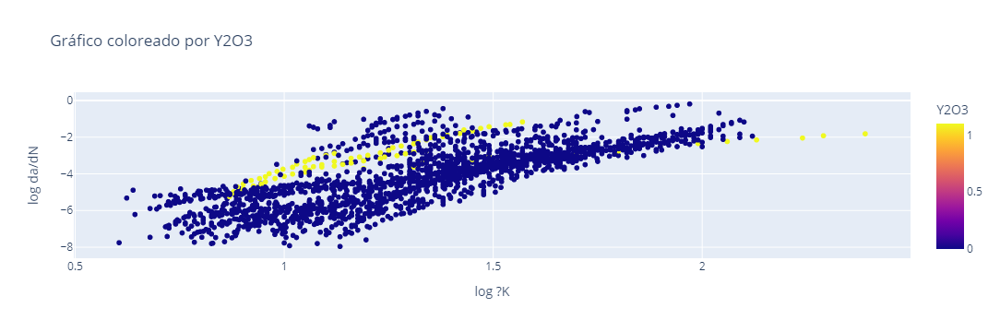

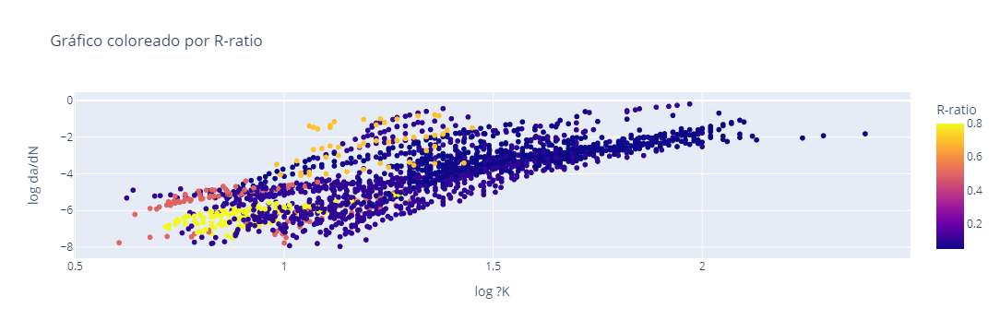

In [27]:
for col in Vars:
    fig = px.scatter(df, x='log ?K', y='log da/dN', color=col, title=f'Gráfico coloreado por {col}')
    fig.show()

In [28]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
da/dN,1874.0,6.408804e-03,0.034315,1.100000e-08,4.185000e-06,0.000100,0.001293,0.646000
log da/dN,1874.0,-4.124758e+00,1.614923,-7.960000e+00,-5.379706e+00,-3.999365,-2.891549,-0.189767
?K,1874.0,2.726771e+01,22.530746,4.030000e+00,1.185000e+01,20.860000,35.000000,246.000000
log ?K,1874.0,1.317771e+00,0.316476,6.050000e-01,1.070000e+00,1.320000,1.544068,2.390000
Temperature,1874.0,6.610768e+02,304.352015,2.930000e+02,2.980000e+02,811.000000,923.000000,1123.000000
Minimum grain size,1874.0,2.955715e+02,1023.610813,7.000000e+00,3.000000e+01,40.000000,100.000000,5000.000000
Maximum grain size,1874.0,3.129840e+02,1021.890575,7.000000e+00,3.000000e+01,50.000000,120.000000,5000.000000
Difference in grain size between,1874.0,-9.031483e-01,5.460149,-3.500000e+01,0.000000e+00,0.000000,0.000000,0.000000
1st step Heat Treatment,1874.0,1.320938e+03,102.908376,1.116000e+03,1.228000e+03,1313.000000,1405.000000,1578.000000
1st Duration,1874.0,2.602455e+00,1.685152,5.000000e-01,1.000000e+00,2.000000,4.000000,7.000000


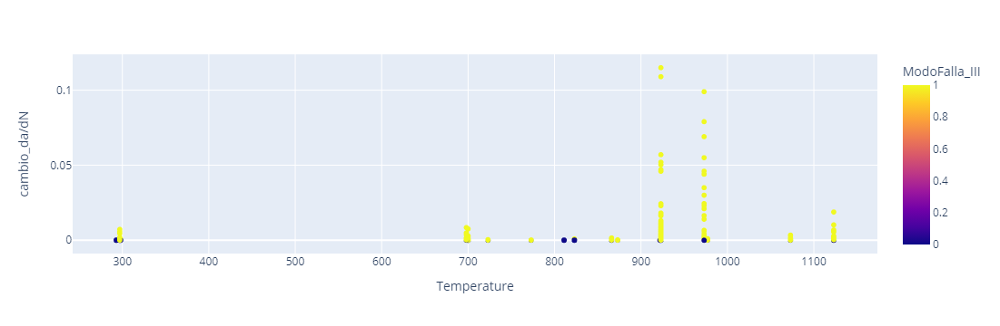

In [29]:
fig = px.scatter(df,x='Temperature', y='cambio_da/dN',color="ModoFalla_III")
fig.show()

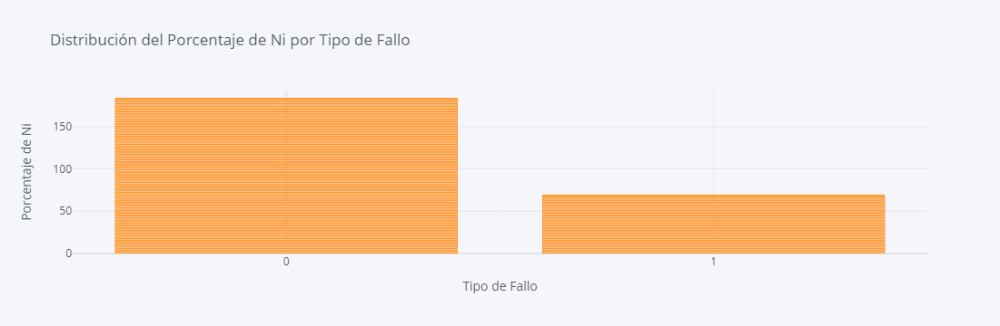

In [30]:
from plotly.offline import plot
cf.go_offline()
fig = df.iplot(kind='bar', x='ModoFalla_III', y='Re', asFigure=True,
               title='Distribución del Porcentaje de Ni por Tipo de Fallo',
               xTitle='Tipo de Fallo', yTitle='Porcentaje de Ni')

fig.show()

In [31]:
df.columns

Index(['da/dN', 'log da/dN', '?K', 'log ?K', 'Temperature',
       'Minimum grain size', 'Maximum grain size',
       'Difference in grain size between', '1st step Heat Treatment',
       '1st Duration', '1st Colling rate', '2nd step Heat Treatment',
       '2nd Duration', '2nd Colling rate', '3rd step Heat Treatment',
       '3 rd Duration', '3 rd Colling rate', 'Frequency', 'Loading Time',
       'Untoading Time', 'Load shape', 'Atmosphere', 'Ni', 'Cr', 'Co', 'Mo',
       'Al', 'Ti', 'Fe', 'C', 'B', 'Zr', 'Si', 'Nb', 'Mn', 'Cu', 'P', 'Ca',
       'Mg', 'S', 'Sn', 'Pb', 'Bi', 'Ag', 'W', 'Ta', 'Hf', 'Re', 'Y2O3',
       'R-ratio', 'Short or long crack growth', 'Sample thickness',
       'Yield stress', 'Sample', 'cambio_da/dN', 'ModoFalla_III'],
      dtype='object')

In [32]:
var_corr = ['da/dN','log da/dN', '?K', 'log ?K', 'Temperature',
       'Minimum grain size', 'Maximum grain size',
       'Difference in grain size between', '1st step Heat Treatment',
       '1st Duration', '1st Colling rate', '2nd step Heat Treatment',
       '2nd Duration', '2nd Colling rate', '3rd step Heat Treatment',
       '3 rd Duration', '3 rd Colling rate', 'Frequency', 'Loading Time',
       'Untoading Time', 'Load shape', 'Atmosphere',
       'R-ratio', 'Short or long crack growth', 'Sample thickness',
       'Yield stress','Sample','cambio_da/dN','ModoFalla_III']

In [33]:
 def graficar_heatmap(df):
            df_correlacion = df
            plt.figure(figsize=(20, 20))
            sns.heatmap(df_correlacion.corr(), annot=True, square= True, cmap='viridis', fmt=".2f")
            plt.title('Mapa de calor')
            return plt.show()

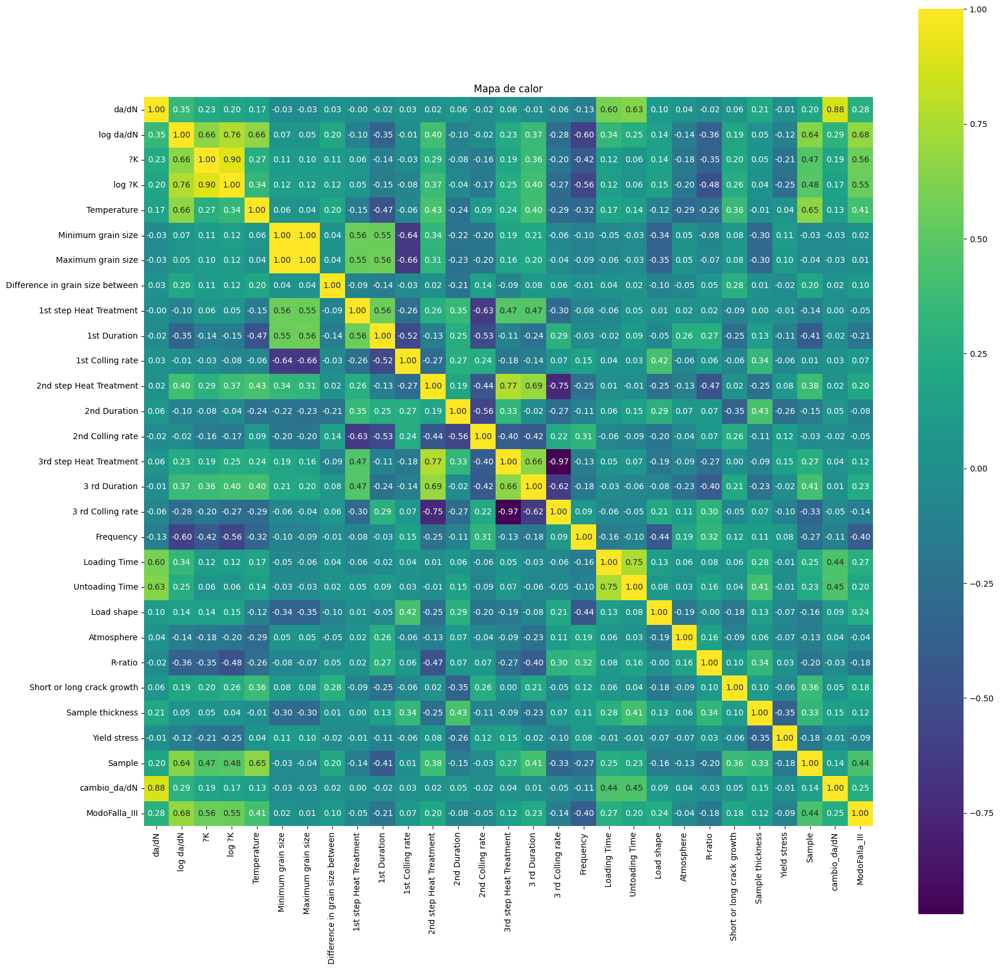

In [34]:
graficar_heatmap(df[var_corr])

In [35]:
var_cor =['da/dN', 'log da/dN', '?K', 'log ?K', 'Temperature',
       'Minimum grain size', 'Maximum grain size',
       'Difference in grain size between', '1st step Heat Treatment',
       '1st Duration', '1st Colling rate', '2nd step Heat Treatment',
       '2nd Duration', '2nd Colling rate', '3rd step Heat Treatment',
       '3 rd Duration', '3 rd Colling rate', 'Frequency', 'Loading Time',
       'Untoading Time', 'Load shape', 'Atmosphere', 'Ni', 'Cr', 'Co', 'Mo',
       'Al', 'Ti', 'Fe', 'C', 'B', 'Zr', 'Si', 'Nb', 'Mn', 'Cu', 'P', 'Ca',
       'Mg', 'S', 'Sn', 'Pb', 'Bi', 'Ag', 'W', 'Ta', 'Hf', 'Re', 'Y2O3',
       'R-ratio', 'Short or long crack growth', 'Sample thickness',
       'Yield stress', 'Sample', 'cambio_da/dN','ModoFalla_III']

In [36]:
target = 'ModoFalla_III'

In [37]:
correlation_matrix = df[var_cor].corr()
target_correlations = correlation_matrix[target].drop(target)
sorted_correlations = target_correlations.sort_values(ascending=False)
sorted_correlations_df = sorted_correlations.reset_index()
sorted_correlations_df.columns = ['Variable', 'Correlation']

sorted_correlations_df.head()

,Variable,Correlation
0,log da/dN,0.682887
1,?K,0.558041
2,log ?K,0.553429
3,Sample,0.436545
4,Temperature,0.410548


In [38]:
sorted_correlations_df.tail()

,Variable,Correlation
50,Mo,-0.216608
51,Ti,-0.216809
52,Co,-0.218602
53,B,-0.239863
54,Frequency,-0.399318


### Preprocesamiento de Datos

In [39]:
VarC = ['log ?K', 'Temperature',
       'Difference in grain size between', '1st step Heat Treatment',
       '1st Duration', '1st Colling rate', '2nd step Heat Treatment',
       '2nd Duration', '2nd Colling rate', '3rd step Heat Treatment',
       '3 rd Duration', '3 rd Colling rate', 'Frequency', 'Loading Time',
       'Untoading Time', 'Atmosphere', 'Ni', 'Cr', 'Co', 'Mo',
       'Al', 'Ti', 'Fe', 'C', 'B', 'Zr', 'Si', 'Nb', 'Mn', 'Cu', 'P', 'Ca',
       'Mg', 'S', 'Sn', 'Pb', 'Bi', 'Ag', 'W', 'Ta', 'Hf', 'Re', 'Y2O3',
       'R-ratio', 'Sample thickness',
       'Yield stress']

In [40]:
VarD = ['Load shape','Short or long crack growth','Sample']

In [41]:
Var = VarC+VarD

In [42]:
targetC = 'log da/dN'
targetD = 'ModoFalla_III'

In [43]:
#Separación de Datos
X = df[Var]
yC = df[targetC]
yD = df[targetD]

In [44]:
X.head()

,log ?K,Temperature,Difference in grain size between,1st step Heat Treatment,1st Duration,1st Colling rate,2nd step Heat Treatment,2nd Duration,2nd Colling rate,3rd step Heat Treatment,...,Ta,Hf,Re,Y2O3,R-ratio,Sample thickness,Yield stress,Load shape,Short or long crack growth,Sample
81,1.000000,293,0.0,1423,4.0,-5.0,923,24,-5.0,1033,...,0.0,0.0,0,0.0,0.5,12.5,954.0,1,1,1
59,0.875061,293,0.0,1423,4.0,-5.0,923,24,-5.0,1033,...,0.0,0.0,0,0.0,0.8,12.5,954.0,1,1,1
82,1.004321,293,0.0,1423,4.0,-5.0,923,24,-5.0,1033,...,0.0,0.0,0,0.0,0.5,12.5,954.0,1,1,1
30,0.778151,293,0.0,1353,4.0,-5.0,923,24,-5.0,1033,...,0.0,0.0,0,0.0,0.5,12.5,1021.0,1,1,1
58,0.863323,293,0.0,1423,4.0,-5.0,923,24,-5.0,1033,...,0.0,0.0,0,0.0,0.8,12.5,954.0,1,1,1


In [45]:
VarC_transformer = Pipeline(steps=[("scaler", StandardScaler())])

In [46]:
VarD_transformer = Pipeline(
    steps=[
        ("encoder", OneHotEncoder(handle_unknown="ignore"))])

In [47]:
preprocessor = ColumnTransformer(
    transformers=[
        ("Continuas", VarC_transformer, VarC),
        ("Discretas", VarD_transformer, VarD),
    ]
)

In [48]:
clf = Pipeline(
    steps=[("preprocessor", preprocessor)]
)
clf

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('Continuas',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  ['log ?K', 'Temperature',
                                                   'Difference in grain size '
                                                   'between',
                                                   '1st step Heat Treatment',
                                                   '1st Duration',
                                                   '1st Colling rate',
                                                   '2nd step Heat Treatment',
                                                   '2nd Duration',
                                                   '2nd Colling rate',
                                                   '3rd step Heat Treatment',
                                                   '3 rd Duration',
                                                   '3 rd Colling rate',
                                                   'Frequency', 'Loading Time',
                                                   'Untoading Time',
                                                   'Atmosphere', 'Ni', 'Cr',
                                                   'Co', 'Mo', 'Al', 'Ti', 'Fe',
                                                   'C', 'B', 'Zr', 'Si', 'Nb',
                                                   'Mn', 'Cu', ...]),
                                                 ('Discretas',
                                                  Pipeline(steps=[('encoder',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['Load shape',
                                                   'Short or long crack growth',
                                                   'Sample'])]))])

In [49]:
X_train, X_test, y_train, y_test = train_test_split(X, yD, test_size=0.3, random_state=42)

In [50]:
clf.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('Continuas',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  ['log ?K', 'Temperature',
                                                   'Difference in grain size '
                                                   'between',
                                                   '1st step Heat Treatment',
                                                   '1st Duration',
                                                   '1st Colling rate',
                                                   '2nd step Heat Treatment',
                                                   '2nd Duration',
                                                   '2nd Colling rate',
                                                   '3rd step Heat Treatment',
                                                   '3 rd Duration',
                                                   '3 rd Colling rate',
                                                   'Frequency', 'Loading Time',
                                                   'Untoading Time',
                                                   'Atmosphere', 'Ni', 'Cr',
                                                   'Co', 'Mo', 'Al', 'Ti', 'Fe',
                                                   'C', 'B', 'Zr', 'Si', 'Nb',
                                                   'Mn', 'Cu', ...]),
                                                 ('Discretas',
                                                  Pipeline(steps=[('encoder',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['Load shape',
                                                   'Short or long crack growth',
                                                   'Sample'])]))])

In [51]:
clf.fit(X_test, y_test)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('Continuas',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  ['log ?K', 'Temperature',
                                                   'Difference in grain size '
                                                   'between',
                                                   '1st step Heat Treatment',
                                                   '1st Duration',
                                                   '1st Colling rate',
                                                   '2nd step Heat Treatment',
                                                   '2nd Duration',
                                                   '2nd Colling rate',
                                                   '3rd step Heat Treatment',
                                                   '3 rd Duration',
                                                   '3 rd Colling rate',
                                                   'Frequency', 'Loading Time',
                                                   'Untoading Time',
                                                   'Atmosphere', 'Ni', 'Cr',
                                                   'Co', 'Mo', 'Al', 'Ti', 'Fe',
                                                   'C', 'B', 'Zr', 'Si', 'Nb',
                                                   'Mn', 'Cu', ...]),
                                                 ('Discretas',
                                                  Pipeline(steps=[('encoder',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['Load shape',
                                                   'Short or long crack growth',
                                                   'Sample'])]))])

## Target Discreta

### Regresión Lógistica 

In [52]:
log_reg = LogisticRegression()

In [53]:
log_reg.fit(X_train, y_train)

C:\Users\PC-ESCRITORIO\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LogisticRegression()

In [54]:
y_pred = log_reg.predict(X_test)

In [55]:
print("Modelo Regresión Lógistica")
print(classification_report(y_test, y_pred))

Modelo Regresión Lógistica
              precision    recall  f1-score   support

           0       0.85      0.94      0.89       414
           1       0.76      0.55      0.64       149

    accuracy                           0.83       563
   macro avg       0.81      0.74      0.77       563
weighted avg       0.83      0.83      0.83       563



In [56]:
y_pred_prob = log_reg.predict_proba(X_test)[:, 1]

# Calcular el AUC-ROC en el conjunto de prueba
auc_roc_test = roc_auc_score(y_test, y_pred_prob)

print("AUC-ROC (test): ", auc_roc_test)

AUC-ROC (test):  0.8966297052815874


In [57]:
scores = cross_val_score(log_reg, X_train, y_train, cv=5, scoring='roc_auc', n_jobs=-1, verbose=1)
scores

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    1.2s finished


array([0.92217195, 0.89630079, 0.89956034, 0.9094148 , 0.90350212])

In [58]:
np.mean(scores), np.std(scores)

(0.9061899986005505, 0.009108188541272742)

### Random Forest

In [59]:
rf_classifier = RandomForestClassifier()

In [60]:
rf_classifier.fit(X_train, y_train)

RandomForestClassifier()

In [61]:
y_pred = rf_classifier.predict(X_test)

In [62]:
print("Modelo Random Forest")
print(classification_report(y_test, y_pred))

Modelo Random Forest
              precision    recall  f1-score   support

           0       0.93      0.94      0.94       414
           1       0.83      0.81      0.82       149

    accuracy                           0.91       563
   macro avg       0.88      0.88      0.88       563
weighted avg       0.91      0.91      0.91       563



In [63]:
y_pred_prob = rf_classifier.predict_proba(X_test)[:, 1]

# Calcular el AUC-ROC en el conjunto de prueba
auc_roc_test = roc_auc_score(y_test, y_pred_prob)

print("AUC-ROC (test): ", auc_roc_test)

AUC-ROC (test):  0.9658836689038031


In [64]:
scores = cross_val_score(rf_classifier, X_train, y_train, cv=5, scoring='roc_auc', n_jobs=-1, verbose=1)
scores

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.8s finished


array([0.96708145, 0.96315949, 0.92472711, 0.94788508, 0.93253487])

In [65]:
np.mean(scores), np.std(scores)

(0.9470775994775389, 0.016555776604053794)

### SVM

In [66]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import reciprocal, uniform

In [67]:
SVC = svm.SVC(kernel = 'poly',probability=True, random_state=42)

In [68]:
SVC.fit(X_train, y_train)

SVC(kernel='poly', probability=True, random_state=42)

In [69]:
y_pred = SVC.predict(X_test)

In [70]:
print("Modelo SVM")
print(classification_report(y_test, y_pred))

Modelo SVM
              precision    recall  f1-score   support

           0       0.75      1.00      0.86       414
           1       0.88      0.09      0.17       149

    accuracy                           0.76       563
   macro avg       0.81      0.54      0.51       563
weighted avg       0.79      0.76      0.68       563



In [71]:
y_pred_prob = SVC.predict_proba(X_test)[:, 1]

# Calcular el AUC-ROC en el conjunto de prueba
auc_roc_test = roc_auc_score(y_test, y_pred_prob)

print("AUC-ROC (test): ", auc_roc_test)

AUC-ROC (test):  0.849479622604805


In [72]:
scores = cross_val_score(SVC, X_train, y_train, cv=5, scoring='roc_auc', n_jobs=-1, verbose=1)
scores

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.7s finished


array([0.84374057, 0.88455124, 0.83747726, 0.88470285, 0.83944815])

In [73]:
np.mean(scores), np.std(scores)

(0.8579840151762529, 0.021848087899879978)

### KNeighborsClassifier

In [74]:
# Definir los hiperparámetros a probar
param_grid = {
    'n_neighbors': [3, 5, 7, 9, 11],    # Número de vecinos
    'metric': ['euclidean', 'manhattan', 'minkowski']  # Métricas de distancia
}

In [75]:
from sklearn.neighbors import KNeighborsClassifier

In [76]:
knn = KNeighborsClassifier()

In [77]:
grid_search = GridSearchCV(estimator=knn, param_grid=param_grid, cv=5, n_jobs=-1)

In [78]:
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'metric': ['euclidean', 'manhattan', 'minkowski'],
                         'n_neighbors': [3, 5, 7, 9, 11]})

In [79]:
print("Mejores hiperparámetros encontrados:")
print(grid_search.best_params_)
print("Exactitud en conjunto de prueba:")
y_pred = grid_search.predict(X_test)

Mejores hiperparámetros encontrados:
{'metric': 'manhattan', 'n_neighbors': 3}
Exactitud en conjunto de prueba:


In [80]:
knn = KNeighborsClassifier(metric = 'manhattan',n_neighbors=3)

In [81]:
knn.fit(X_train, y_train)

KNeighborsClassifier(metric='manhattan', n_neighbors=3)

In [82]:
y_pred = knn.predict(X_test)

In [83]:
print("Modelo KNeighborsClassifier")
print(classification_report(y_test, y_pred))

Modelo KNeighborsClassifier
              precision    recall  f1-score   support

           0       0.94      0.95      0.95       414
           1       0.86      0.85      0.85       149

    accuracy                           0.92       563
   macro avg       0.90      0.90      0.90       563
weighted avg       0.92      0.92      0.92       563



In [84]:
y_pred_prob = knn.predict_proba(X_test)[:, 1]

# Calcular el AUC-ROC en el conjunto de prueba
auc_roc_test = roc_auc_score(y_test, y_pred_prob)

print("AUC-ROC (test): ", auc_roc_test)

AUC-ROC (test):  0.9426693252926109


In [85]:
scores = cross_val_score(knn, X_train, y_train, cv=5, scoring='roc_auc', n_jobs=-1, verbose=1)
scores

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.0s finished


array([0.92809201, 0.95087932, 0.9137356 , 0.90452547, 0.91191631])

In [86]:
np.mean(scores), np.std(scores)

(0.9218297414128221, 0.016409284344436694)

###  Naive Bayes 

In [87]:
from sklearn.naive_bayes import GaussianNB

In [88]:
param_grid = {
    'var_smoothing': [1e-9, 1e-8, 1e-7]  # Hiperparámetro específico de GaussianNB
}

In [89]:
nb_classifier = GaussianNB()

In [90]:
grid_search = GridSearchCV(estimator=nb_classifier, param_grid=param_grid, cv=5, n_jobs=-1)

In [91]:
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=GaussianNB(), n_jobs=-1,
             param_grid={'var_smoothing': [1e-09, 1e-08, 1e-07]})

In [92]:
print("Mejores hiperparámetros encontrados:")
print(grid_search.best_params_)

Mejores hiperparámetros encontrados:
{'var_smoothing': 1e-07}


In [93]:
nb_classifier = GaussianNB(var_smoothing=1e-07)

In [94]:
nb_classifier.fit(X_train, y_train)

GaussianNB(var_smoothing=1e-07)

In [95]:
y_pred = nb_classifier.predict(X_test)

In [96]:
print("Modelo Naive Bayes")
print(classification_report(y_test, y_pred))

Modelo Naive Bayes
              precision    recall  f1-score   support

           0       0.94      0.68      0.79       414
           1       0.49      0.88      0.63       149

    accuracy                           0.73       563
   macro avg       0.72      0.78      0.71       563
weighted avg       0.82      0.73      0.75       563



In [97]:
y_pred_prob = nb_classifier.predict_proba(X_test)[:, 1]

# Calcular el AUC-ROC en el conjunto de prueba
auc_roc_test = roc_auc_score(y_test, y_pred_prob)

print("AUC-ROC (test): ", auc_roc_test)

AUC-ROC (test):  0.8643695490062575


In [98]:
scores = cross_val_score(nb_classifier, X_train, y_train, cv=5, scoring='roc_auc', n_jobs=-1, verbose=1)
scores

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.0s finished


array([0.8841629 , 0.88424803, 0.88311098, 0.90744391, 0.85612492])

In [99]:
np.mean(scores), np.std(scores)

(0.8830181461958297, 0.016264653598738472)

### Gradient Boosting (XGBoost)

In [100]:
import xgboost as xgb

In [101]:
xgb_model = xgb.XGBClassifier(scale_pos_weight=sum(y_train == 0) / sum(y_train == 1), random_state=42)

In [102]:
xgb_model.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

In [103]:
y_pred = xgb_model.predict(X_test)

In [104]:
print("XGBoost")
print(classification_report(y_test, y_pred))

XGBoost
              precision    recall  f1-score   support

           0       0.95      0.93      0.94       414
           1       0.81      0.86      0.83       149

    accuracy                           0.91       563
   macro avg       0.88      0.89      0.88       563
weighted avg       0.91      0.91      0.91       563



In [105]:
y_pred_prob = xgb_model.predict_proba(X_test)[:, 1]

# Calcular el AUC-ROC en el conjunto de prueba
auc_roc_test = roc_auc_score(y_test, y_pred_prob)

print("AUC-ROC (test): ", auc_roc_test)

AUC-ROC (test):  0.9682180721719678


In [106]:
scores = cross_val_score(xgb_model, X_train, y_train, cv=5, scoring='roc_auc', n_jobs=-1, verbose=1)
scores

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.1s finished


array([0.96613876, 0.95796695, 0.93825804, 0.94413281, 0.93617344])

In [107]:
np.mean(scores), np.std(scores)

(0.9485339988493415, 0.01163320811115973)

In [108]:
xgb_model = xgb.XGBClassifier(random_state=42)

In [109]:
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0],
    'gamma': [0, 1, 5],
    'scale_pos_weight': [1, sum(y_train == 0) / sum(y_train == 1)]
}

In [110]:
grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=5, scoring='roc_auc', n_jobs=-1, verbose=2)

In [111]:
grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 648 candidates, totalling 3240 fits


GridSearchCV(cv=5,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     feature_types=None, gamma=None,
                                     grow_policy=None, importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None,...
                                     missing=nan, monotone_constraints=None,
                                     multi_strategy=None, n_estimators=None,
                                     n_jobs=None, num_parallel_tree=None,
                                     random_state=42, ...),
             n_jobs=-1,
             param_grid={'colsample_bytree': [0.8, 1.0], 'gamma': [0, 1, 5],
                         'learning_rate': [0.01, 0.1, 0.2],
                         'max_depth': [3, 5, 7],
                         'n_estimators': [100, 200, 300],
                         'scale_pos_weight': [1, 2.8558823529411765],
                         'subsample': [0.8, 1.0]},
             scoring='roc_auc', verbose=2)

In [166]:
# Mejor modelo
best_xgb = grid_search.best_estimator_

In [167]:
# Evaluar el mejor modelo en el conjunto de prueba
y_pred_prob = best_xgb.predict_proba(X_test)[:, 1]
auc_roc_test = roc_auc_score(y_test, y_pred_prob)

print("Mejores Hiperparámetros:", grid_search.best_params_)
print("AUC-ROC (test) con el mejor modelo:", auc_roc_test)

Mejores Hiperparámetros: {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'max_depth': 3, 'min_child_samples': 40, 'n_estimators': 100, 'num_leaves': 20, 'scale_pos_weight': 1, 'subsample': 0.8}
AUC-ROC (test) con el mejor modelo: 0.9684693447459715


In [168]:
y_pred = best_xgb.predict(X_test)

In [169]:
print("XGBoost")
print(classification_report(y_test, y_pred))

XGBoost
              precision    recall  f1-score   support

           0       0.97      0.89      0.93       414
           1       0.76      0.92      0.83       149

    accuracy                           0.90       563
   macro avg       0.86      0.91      0.88       563
weighted avg       0.91      0.90      0.90       563



In [170]:
xgb_model1 = xgb.XGBClassifier(colsample_bytree=1.0, gamma=1, learning_rate=0.1, max_depth=3, n_estimators=300, scale_pos_weight=1, subsample=0.8)

In [171]:
xgb_model1.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=1.0, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=1, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=3, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=300, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

In [172]:
scores = cross_val_score(xgb_model1, X_train, y_train, cv=5, scoring='roc_auc', n_jobs=-1, verbose=1)
scores

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    3.2s finished


array([0.97443439, 0.97028502, 0.95228169, 0.95732262, 0.94750606])

In [173]:
np.mean(scores), np.std(scores)

(0.9603659560572841, 0.010356667416858208)

In [174]:
y_pred = xgb_model1.predict(X_test)

In [175]:
print("XGBoost")
print(classification_report(y_test, y_pred))

XGBoost
              precision    recall  f1-score   support

           0       0.95      0.94      0.95       414
           1       0.84      0.87      0.85       149

    accuracy                           0.92       563
   macro avg       0.90      0.90      0.90       563
weighted avg       0.92      0.92      0.92       563



### Gradient Boosting (lightgbm)

In [176]:
import lightgbm as lgb

In [177]:
lgb_model = lgb.LGBMClassifier(is_unbalance=True, random_state=42)

In [178]:
lgb_model.fit(X_train, y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 340, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000138 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 662
[LightGBM] [Info] Number of data points in the train set: 1311, number of used features: 49
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.259344 -> initscore=-1.049381
[LightGBM] [Info] Start training from score -1.049381
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


LGBMClassifier(is_unbalance=True, random_state=42)

In [179]:
scores = cross_val_score(lgb_model, X_train, y_train, cv=5, scoring='roc_auc', n_jobs=-1, verbose=1)
scores

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    1.0s finished


array([0.96968326, 0.95861128, 0.9375758 , 0.94572468, 0.94102486])

In [180]:
np.mean(scores), np.std(scores)

(0.9505239772356207, 0.011944907676216006)

In [181]:
y_pred_prob = lgb_model.predict_proba(X_test)[:, 1]

# Calcular el AUC-ROC en el conjunto de prueba
auc_roc_test = roc_auc_score(y_test, y_pred_prob)

print("AUC-ROC (test): ", auc_roc_test)

AUC-ROC (test):  0.9679424828972538


In [286]:
y_pred = lgb_model.predict(X_test)

In [182]:
y_pred = lgb_model.predict(X_test)

In [183]:
print("lgb_model")
print(classification_report(y_test, y_pred))

lgb_model
              precision    recall  f1-score   support

           0       0.96      0.93      0.94       414
           1       0.82      0.89      0.85       149

    accuracy                           0.92       563
   macro avg       0.89      0.91      0.90       563
weighted avg       0.92      0.92      0.92       563



In [184]:
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'num_leaves': [20, 31, 40],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0],
    'min_child_samples': [20, 30, 40],
    'scale_pos_weight': [1, sum(y_train == 0) / sum(y_train == 1)]
}

In [185]:
grid_search = GridSearchCV(estimator=lgb_model, param_grid=param_grid, cv=5, scoring='roc_auc', n_jobs=-1, verbose=2)

In [186]:
grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 1944 candidates, totalling 9720 fits
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 340, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000233 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 659
[LightGBM] [Info] Number of data points in the train set: 1311, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.259344 -> initscore=-1.049381
[LightGBM] [Info] Start training from score -1.049381
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

C:\Users\PC-ESCRITORIO\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py:547: FitFailedWarning:


4860 fits failed out of a total of 9720.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
4860 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\PC-ESCRITORIO\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\PC-ESCRITORIO\AppData\Local\Programs\Python\Python312\Lib\site-packages\lightgbm\sklearn.py", line 1268, in fit
    super().fit(
  File "C:\Users\PC-ESCRITORIO\AppData\Local\Programs\Python\Python312\Lib\site-p

GridSearchCV(cv=5, estimator=LGBMClassifier(is_unbalance=True, random_state=42),
             n_jobs=-1,
             param_grid={'colsample_bytree': [0.8, 1.0],
                         'learning_rate': [0.01, 0.1, 0.2],
                         'max_depth': [3, 5, 7],
                         'min_child_samples': [20, 30, 40],
                         'n_estimators': [100, 200, 300],
                         'num_leaves': [20, 31, 40],
                         'scale_pos_weight': [1, 2.8558823529411765],
                         'subsample': [0.8, 1.0]},
             scoring='roc_auc', verbose=2)

In [187]:
best_lgb = grid_search.best_estimator_

In [188]:
y_pred_prob = best_lgb.predict_proba(X_test)[:, 1]
auc_roc_test = roc_auc_score(y_test, y_pred_prob)

print("Mejores Hiperparámetros:", grid_search.best_params_)
print("AUC-ROC (test) con el mejor modelo:", auc_roc_test)

Mejores Hiperparámetros: {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'max_depth': 3, 'min_child_samples': 40, 'n_estimators': 100, 'num_leaves': 20, 'scale_pos_weight': 1, 'subsample': 0.8}
AUC-ROC (test) con el mejor modelo: 0.9684693447459715


In [189]:
scores = cross_val_score(best_lgb, X_train, y_train, cv=5, scoring='roc_auc', n_jobs=-1, verbose=1)
scores

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.0s finished


array([0.9714178 , 0.97134627, 0.94750606, 0.96134021, 0.94868102])

In [190]:
np.mean(scores), np.std(scores)

(0.9600582715243116, 0.010441272930631487)

In [191]:
y_pred = best_lgb.predict(X_test)

In [192]:
print("XGBoost")
print(classification_report(y_test, y_pred))

XGBoost
              precision    recall  f1-score   support

           0       0.97      0.89      0.93       414
           1       0.76      0.92      0.83       149

    accuracy                           0.90       563
   macro avg       0.86      0.91      0.88       563
weighted avg       0.91      0.90      0.90       563



### Reporte de estabilidad de los modelos 
(Considerar un periodo/conjunto OOT, donde se vean los criterios de PSI, CSI,) [Clasificación] (KS entre la distribución de 1s y 0s, TE/TNE)

### PSI

In [193]:
train_proba = best_lgb.predict_proba(X_train)[:, 1]
test_ott = best_lgb.predict_proba(X_test)[:, 1]

In [194]:
def calculate_psi(expected, actual, buckets=10):
    def scale_range(input, min, max):
        input += -(np.min(input))
        input /= np.max(input) / (max - min)
        input += min
        return input

    expected_percents, bins = np.histogram(expected, bins=buckets, density=True)
    actual_percents, _ = np.histogram(actual, bins=bins, density=True)
    
    psi_value = np.sum((expected_percents - actual_percents) * np.log(expected_percents / actual_percents))
    
    return psi_value


In [195]:
psi_value = calculate_psi(train_proba, test_ott)
print(f'PSI: {psi_value}')

PSI: 0.1041399171925846


In [196]:
import seaborn as sns

def calculate_psi(expected, actual, buckets=10):
    def scale_range(input, min, max):
        input += -(np.min(input))
        input /= np.max(input) / (max - min)
        input += min
        return input

    expected_percents, bins = np.histogram(expected, bins=buckets, density=True)
    actual_percents, _ = np.histogram(actual, bins=bins, density=True)
    
    psi_value = np.sum((expected_percents - actual_percents) * np.log(expected_percents / actual_percents))
    
    return psi_value, expected_percents, actual_percents, bins

def plot_psi(expected, actual, buckets=10):
    psi_value, expected_percents, actual_percents, bins = calculate_psi(expected, actual, buckets)
    
    plt.figure(figsize=(10, 6))
    width = 0.4  # Width of the bars
    
    # Calculate the mid points of the bins for plotting
    bin_centers = (bins[:-1] + bins[1:]) / 2
    
    # Plot expected and actual distributions
    plt.bar(bin_centers - width/2, expected_percents, width=width, label='Expected', alpha=0.7)
    plt.bar(bin_centers + width/2, actual_percents, width=width, label='Actual', alpha=0.7)
    
    plt.title(f'Population Stability Index (PSI): {psi_value:.4f}')
    plt.xlabel('Score Bins')
    plt.ylabel('Percentage')
    plt.legend(loc='best')
    
    plt.show()

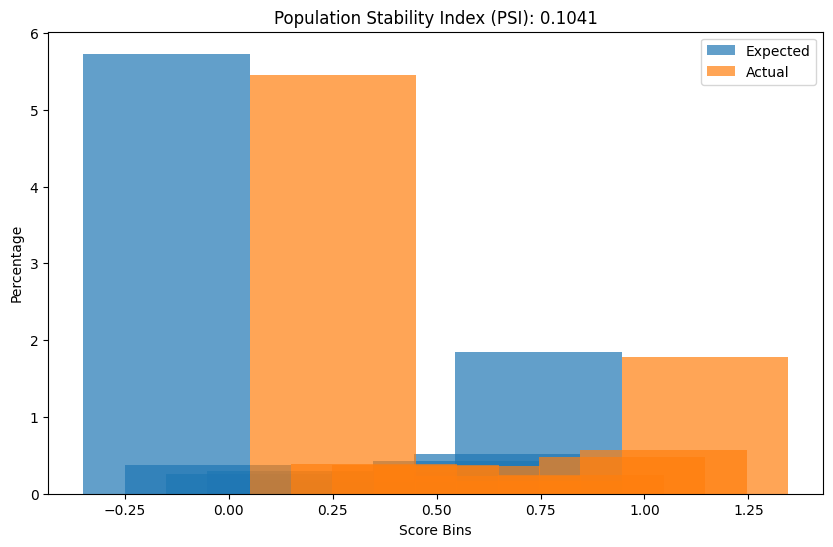

In [197]:
plot_psi(train_proba, test_ott)

### CSI

In [268]:
variables = ['log ?K', 'Temperature', 'Difference in grain size between',
       '1st step Heat Treatment', '1st Duration', '1st Colling rate',
       '2nd step Heat Treatment', '2nd Duration', '2nd Colling rate',
       '3rd step Heat Treatment', '3 rd Duration', '3 rd Colling rate',
       'Frequency', 'Loading Time', 'Untoading Time', 'Atmosphere', 'Ni', 'Cr',
       'Co', 'Mo', 'Al', 'Ti', 'Fe', 'C', 'B', 'Zr', 'Si', 'Nb', 'Mn', 'Cu',
       'P', 'Ca', 'Mg', 'S', 'Sn', 'Pb', 'Bi', 'Ag', 'W', 'Ta', 'Hf', 'Re',
       'Y2O3', 'R-ratio', 'Sample thickness', 'Yield stress', 'Load shape',
       'Short or long crack growth', 'Sample']

In [269]:
def calculate_csi(train_data, test_data, feature_columns, buckets=100):
    csi_values = {}
    
    for feature in feature_columns:
        train_values = train_data[feature]
        test_values = test_data[feature]
        
        # Calculate histogram and densities with smaller bins
        train_percents, bins = np.histogram(train_values, bins=buckets, density=True)
        test_percents, _ = np.histogram(test_values, bins=bins, density=True)
        
        # Handle edge case: if all values in train_percents or test_percents are zero
        train_percents = np.where(train_percents == 0, 1e-10, train_percents)
        test_percents = np.where(test_percents == 0, 1e-10, test_percents)
        
        # Calculate CSI
        csi_value = np.sum((train_percents - test_percents) * np.log(train_percents / test_percents))
        
        csi_values[feature] = csi_value
    
    return csi_values

In [271]:
csi_values_orig = calculate_csi(X_train, X_test, variables)
print("CSI Values:")
for feature, value in csi_values_orig.items():
    print(f'{feature}: {value}')

CSI Values:
log ?K: 30.38603081529428
Temperature: 0.0024949604357512056
Difference in grain size between: 0.0013305375115674198
1st step Heat Treatment: 0.008625376109483577
1st Duration: 0.06807339815828388
1st Colling rate: 0.056662151311195064
2nd step Heat Treatment: 0.0010897363619136661
2nd Duration: 0.03614710617443184
2nd Colling rate: 0.31504701776443744
3rd step Heat Treatment: 0.001019905339974733
3 rd Duration: 0.03248244251873267
3 rd Colling rate: 0.06975967064745012
Frequency: 0.012638541781874315
Loading Time: 0.005486084939815052
Untoading Time: 0.0006986231483839811
Atmosphere: 0.000782796739326167
Ni: 0.11835300408134293
Cr: 0.152125365170736
Co: 0.10220891817295581
Mo: 0.6013520935084049
Al: 0.9622457548511179
Ti: 0.6444011564851008
Fe: 0.0784466101470756
C: 69.95496947039695
B: 15.461215297465081
Zr: 3.8282931775787965
Si: 6.441657128636558
Nb: 0.25588091143280106
Mn: 6.488942340555142
Cu: 7.054390147843231
P: 44.209625776862154
Ca: 14.56338925866057
Mg: 43.690167

In [249]:
x_train_transformed = clf.transform(X_train)
x_test_transformed = clf.transform(X_test)

In [250]:
x_train_df = pd.DataFrame(x_train_transformed)
x_test_df = pd.DataFrame(x_test_transformed)

In [255]:
num_features = x_test_transformed.shape[1]
column_names = [f'feature_{i}' for i in range(num_features)]

In [259]:
x_train_df.columns = [column_names] 
x_test_df.columns = [column_names] 

In [261]:
csi_values = calculate_csi(x_train_df, x_test_df, column_names)
print("CSI Values:")
for feature, value in csi_values.items():
    print(f'{feature}: {value}')

CSI Values:
feature_0: 9.27205594912182
feature_1: 0.7639790729070518
feature_2: 0.007034453788395239
feature_3: 0.9029375865138041
feature_4: 0.11743480488462993
feature_5: 0.18024450586022225
feature_6: 0.34488616876768774
feature_7: 0.32725305558032497
feature_8: 0.7300654031691859
feature_9: 0.3327389048388424
feature_10: 0.20468288276043387
feature_11: 0.11366403962364727
feature_12: 0.38953844902214596
feature_13: 0.43170158577308043
feature_14: 0.041506010343342774
feature_15: 0.18221976196884482
feature_16: 0.9947810115317646
feature_17: 0.7866462404469711
feature_18: 0.7590433807587893
feature_19: 1.2191102691029418
feature_20: 1.694146750741923
feature_21: 0.7083223152983131
feature_22: 0.9596050896647891
feature_23: 0.7791147244933858
feature_24: 0.43369806186639837
feature_25: 0.1557496696397523
feature_26: 0.5819599282544086
feature_27: 0.6167462548017724
feature_28: 0.5202749995860793
feature_29: 0.09472120806996158
feature_30: 0.10276949991045028
feature_31: 0.0169322739

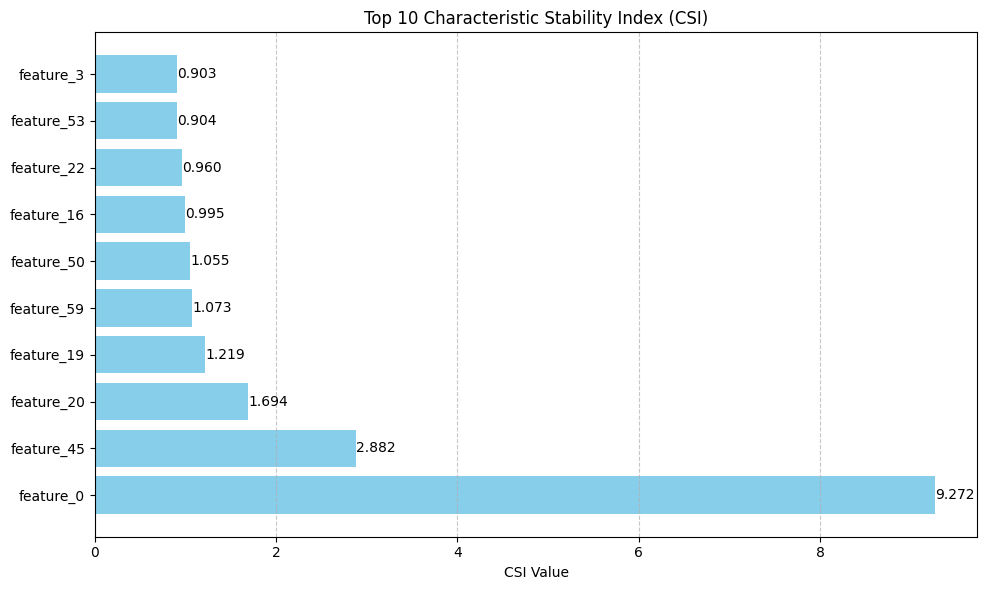

In [266]:
csi_df = pd.DataFrame(list(csi_values.items()), columns=['Feature', 'CSI Value'])
csi_df = csi_df.sort_values(by='CSI Value', ascending=False).head(10)  # Seleccionar las 10 variables con mayor CSI

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
plt.barh(csi_df['Feature'], csi_df['CSI Value'], color='skyblue')
plt.xlabel('CSI Value')
plt.title('Top 10 Characteristic Stability Index (CSI)')
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Mostrar los valores de CSI encima de las barras
for index, value in enumerate(csi_df['CSI Value']):
    plt.text(value, index, f'{value:.3f}', va='center', ha='left')

plt.tight_layout()
plt.show()

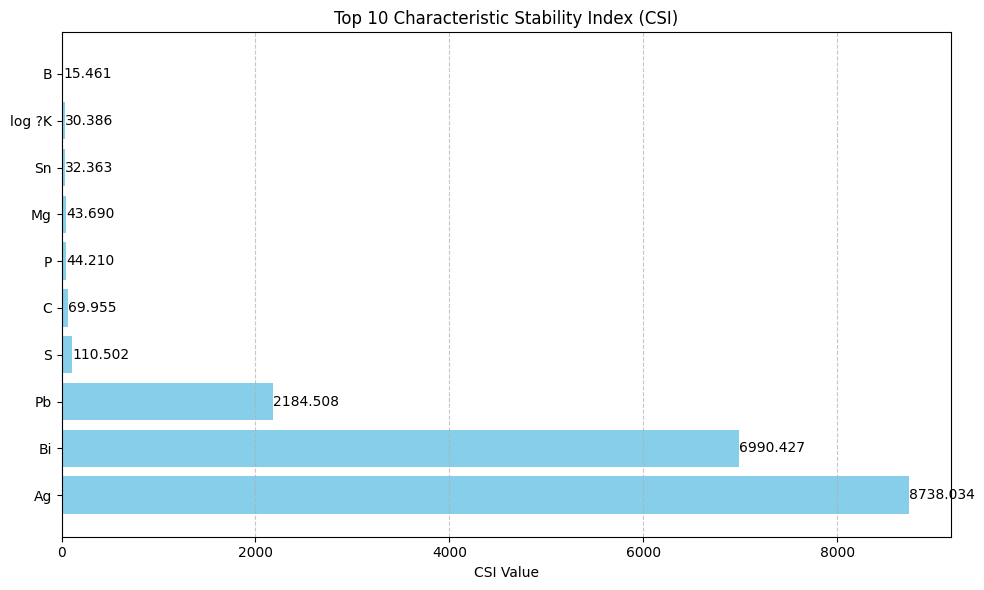

In [272]:
csi_df = pd.DataFrame(list(csi_values_orig.items()), columns=['Feature', 'CSI Value'])
csi_df = csi_df.sort_values(by='CSI Value', ascending=False).head(10)  # Seleccionar las 10 variables con mayor CSI

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
plt.barh(csi_df['Feature'], csi_df['CSI Value'], color='skyblue')
plt.xlabel('CSI Value')
plt.title('Top 10 Characteristic Stability Index (CSI)')
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Mostrar los valores de CSI encima de las barras
for index, value in enumerate(csi_df['CSI Value']):
    plt.text(value, index, f'{value:.3f}', va='center', ha='left')

plt.tight_layout()
plt.show()

### Kolmogorov-Smirnov (KS)

In [273]:
from scipy.stats import ks_2samp

def calculate_ks(y_true, y_pred):
    positive_scores = y_pred[y_true == 1]
    negative_scores = y_pred[y_true == 0]
    
    ks_statistic, p_value = ks_2samp(positive_scores, negative_scores)
    
    return ks_statistic, p_value

In [274]:
ks_statistic, p_value = calculate_ks(y_test, y_pred_prob)
print(f'KS Statistic: {ks_statistic}, p-value: {p_value}')

KS Statistic: 0.8250008105566904, p-value: 3.382995983116266e-77


### True Error (TE) y True Negative Error (TNE)

In [325]:
from sklearn.metrics import confusion_matrix

def calculate_te_tne(y_true, y_pred, threshold=0.41):
    y_pred_binary = (y_pred >= threshold).astype(int)
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred_binary).ravel()
    
    te = fn / (fn + tp)  # True Error (TE)
    tne = fp / (fp + tn)  # True Negative Error (TNE)
    
    return te, tne

# Uso:
te, tne = calculate_te_tne(y_test, y_pred)
print(f'TE: {te}, TNE: {tne}')

TE: 0.10738255033557047, TNE: 0.07246376811594203


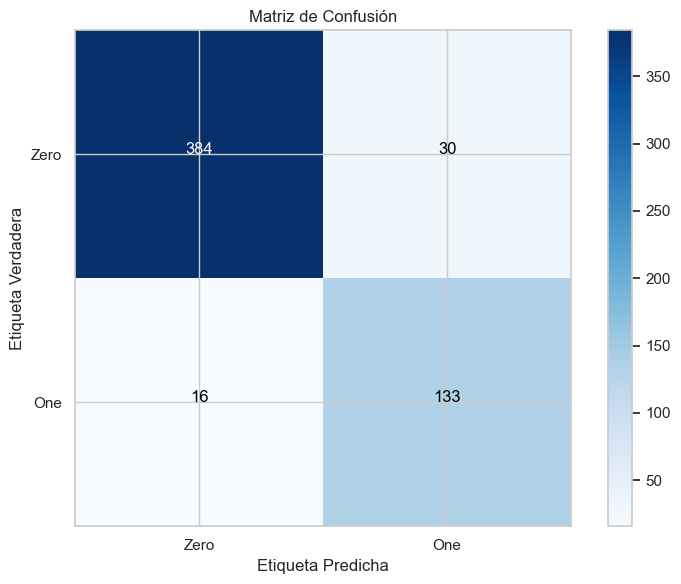

In [287]:
# Calcular la matriz de confusión
cm = confusion_matrix(y_test, y_pred)

# Definir etiquetas para la matriz de confusión
labels = ['True Negative', 'False Positive', 'False Negative', 'True Positive']
categories = ['Zero', 'One']  # Cambia según tus clases

# Crear la figura y el eje
plt.figure(figsize=(8, 6))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Matriz de Confusión')
plt.colorbar()

tick_marks = np.arange(len(categories))
plt.xticks(tick_marks, categories)
plt.yticks(tick_marks, categories)

# Añadir anotaciones
thresh = cm.max() / 2.
for i, j in np.ndindex(cm.shape):
    plt.text(j, i, f'{cm[i, j]}', horizontalalignment='center',
             color='white' if cm[i, j] > thresh else 'black')

plt.ylabel('Etiqueta Verdadera')
plt.xlabel('Etiqueta Predicha')
plt.tight_layout()

# Mostrar la gráfica
plt.show()

### Criterio de selección del punto de corte o partición de la distribución de probabilidades para las estrategias

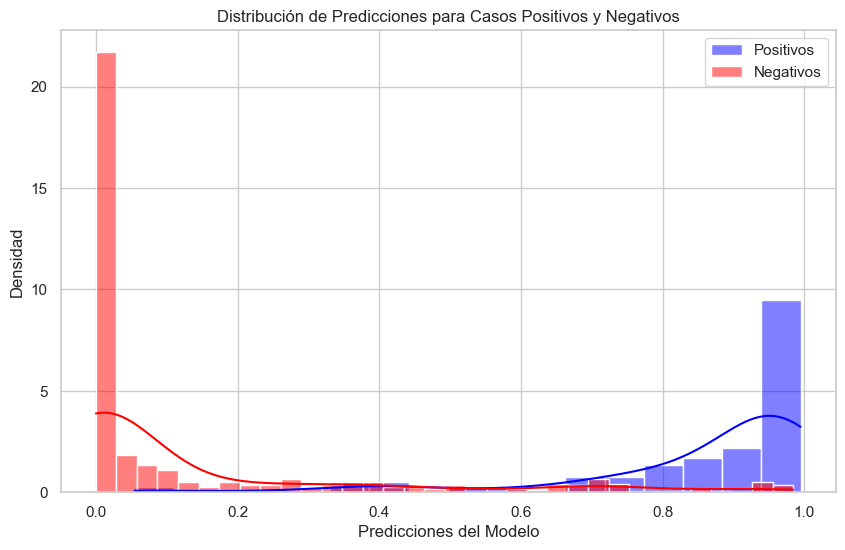

In [281]:
positivos = y_pred_prob[y_test == 1]
negativos = y_pred_prob[y_test == 0]

# Crear histograma de densidad usando Seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))

# Histograma de densidad para positivos
sns.histplot(positivos, kde=True, color='blue', label='Positivos', stat='density')

# Histograma de densidad para negativos
sns.histplot(negativos, kde=True, color='red', label='Negativos', stat='density')

# Configuración del gráfico
plt.title('Distribución de Predicciones para Casos Positivos y Negativos')
plt.xlabel('Predicciones del Modelo')
plt.ylabel('Densidad')
plt.legend()

# Mostrar gráfico
plt.show()

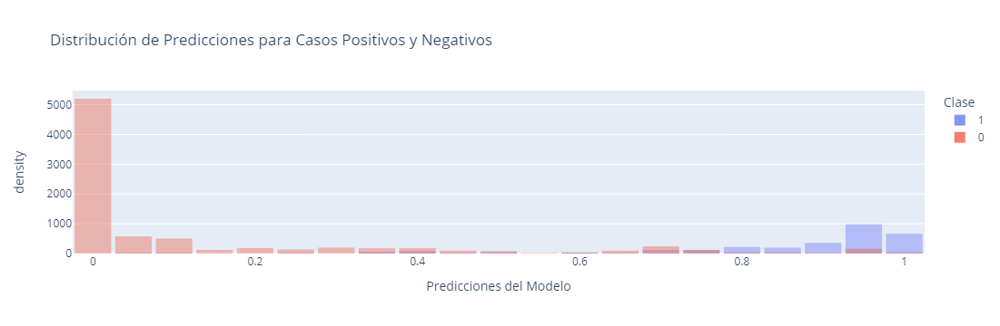

In [290]:
df = pd.DataFrame({'y_pred': y_pred_prob, 'y_true': y_test})

# Filtrar datos positivos y negativos
positivos = df[df['y_true'] == 1]['y_pred']
negativos = df[df['y_true'] == 0]['y_pred']

# Crear figuras con Plotly
fig = px.histogram(df, x='y_pred', color='y_true', nbins=30, barmode='overlay', histnorm='density', 
                   labels={'y_pred': 'Predicciones del Modelo', 'y_true': 'Clase'},
                   title='Distribución de Predicciones para Casos Positivos y Negativos')
fig.update_traces(opacity=0.75)
fig.update_layout(bargap=0.1)
fig.show()

In [291]:
from sklearn.metrics import roc_curve

def youden_threshold(y_true, y_pred):
    fpr, tpr, thresholds = roc_curve(y_true, y_prob)
    youden_index = tpr - fpr
    optimal_threshold = thresholds[np.argmax(youden_index)]
    return optimal_threshold

In [297]:
optimal_threshold =youden_threshold(y_test, y_pred_prob)
optimal_threshold

0.4056358573398095

In [298]:
y_pred_youden = (y_pred_prob >= optimal_threshold).astype(int)

In [303]:
tn, fp, fn, tp = confusion_matrix(y_test, y_pred_youden).ravel()

accuracy = (tp + tn) / (tp + tn + fp + fn)
precision = tp / (tp + fp)
recall = tp / (tp + fn)
specificity = tn / (tn + fp)
f1_score = 2 * (precision * recall) / (precision + recall)

# AUC (Area Under the Curve) ROC
auc_roc = roc_auc_score(y_test, y_pred_prob)

print(f'Umbral óptimo (Youden): {optimal_threshold:.2f}')
print(f'Accuracy: {accuracy:.2f}')
print(f'Precision: {precision:.2f}')
print(f'Recall (Sensibilidad): {recall:.2f}')
print(f'Especificidad: {specificity:.2f}')
print(f'F1 Score: {f1_score:.2f}')
print(f'AUC ROC: {auc_roc:.2f}')

Umbral óptimo (Youden): 0.41
Accuracy: 0.89
Precision: 0.73
Recall (Sensibilidad): 0.95
Especificidad: 0.87
F1 Score: 0.83
AUC ROC: 0.97


In [326]:
# Umbral óptimo seleccionado
umbral = 0.41

# Clasificar las predicciones en 3 bins según el umbral
bin1_positivos = np.sum((y_pred_prob >= umbral) & (y_pred_prob < 0.60))
bin2_positivos = np.sum((y_pred_prob > 0.60) & (y_pred_prob < 0.80))
bin3_positivos = np.sum(y_pred_prob > 0.80)

# Crear una tabla o imprimir los resultados
print("Tabla de casos positivos en 3 bins:")
print("-----------------------------------")
print(f"Bin 1 (prob >= {umbral}<= prob < 0.60): {bin1_positivos} casos positivos")
print(f"Bin 2 (0.60 > prob < 0.70): {bin2_positivos} casos positivos")
print(f"Bin 3 (prob > 0.80): {bin3_positivos} casos positivos")

Tabla de casos positivos en 3 bins:
-----------------------------------
Bin 1 (prob >= 0.41<= prob < 0.60): 19 casos positivos
Bin 2 (0.60 > prob < 0.70): 42 casos positivos
Bin 3 (prob > 0.80): 131 casos positivos


In [323]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

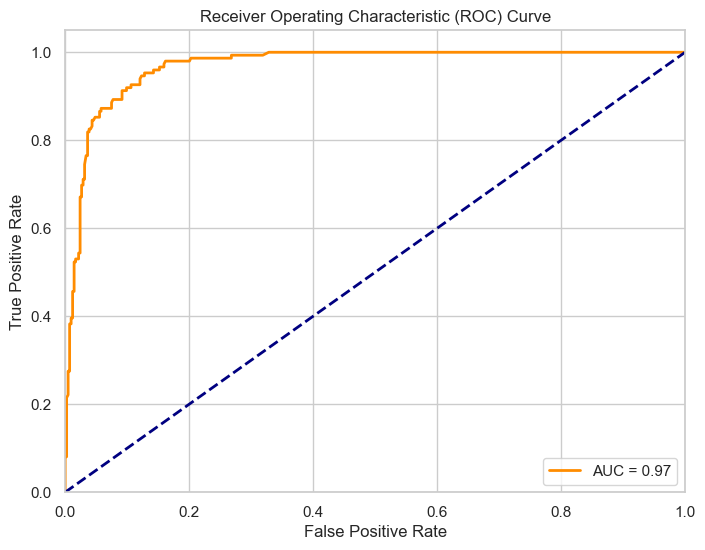

In [324]:
fpr, tpr, _ = roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

# Grafica la curva ROC
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'AUC = {roc_auc:.2f}')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

### Interpretabilidad (Shap Values)

In [315]:
import shap

In [320]:
explainer = shap.Explainer(best_lgb, X_train, feature_names=variables)
shap_values = explainer(X_test)

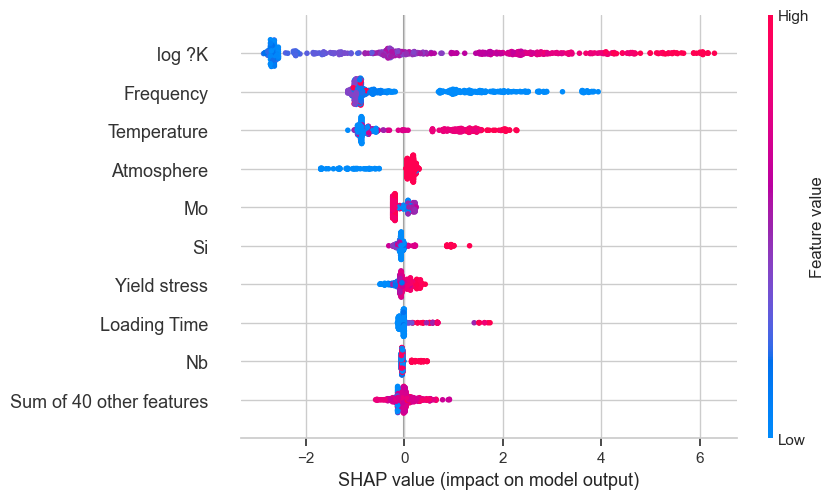

In [321]:
shap.plots.beeswarm(shap_values)